In [1]:
import scanpy as sc
import seaborn as sns
import pandas as pd
from scipy.stats import median_abs_deviation
import numpy as np
import matplotlib.pyplot as plt
import scrublet as scr


# Goals

- QC metrics
- Plot cell type annotaions

# Load Adata

In [2]:
ADATA_PATH = '/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-H1/adata/labelled_adata.h5ad'
adata = sc.read_h5ad(ADATA_PATH)

print(adata)

AnnData object with n_obs × n_vars = 34704 × 38606
    obs: 'x', 'y', 'pct_intronic', 'is_cell', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Neighborhood_aggregate_probability', 'Neighborhood_correlation_coefficient', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Class_aggregate_probability', 'Class_correlation_coefficient', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Subclass_aggregate_probability', 'Subclass_correlation_coefficient', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Group_aggregate_probability', 'Group_correlation_coefficient', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Cluster_aggregate_probability', 'Cluster_correlation_coefficient'
    var: 'feature_types', 'genome', 'gene_symbol'
    obsm: 'spatial'
    layers: 'counts'


# Calculate QC Metrics

In [3]:
# Calculate qc
adata.var["mt"] = adata.var.gene_symbol.str.startswith("MT-") # mitochondrial genes, ATTNETION: the names are in "gene_symbol"
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], inplace=True)

In [4]:
# scrub = scr.Scrublet(adata.X, expected_doublet_rate=0.06)
#     # raw count matrix
#     # for single sample
# doublet_scores, predicted_doublets = scrub.scrub_doublets(
#     min_counts=2,
#     min_cells=3,
#     min_gene_variability_pctl=85,
#     n_prin_comps=30
# )

# adata.obs['doublet_score'] = doublet_scores
# adata.obs['predicted_doublet'] = predicted_doublets

# print(f"\nScrublet results:")
# print(f"  Predicted doublets: {predicted_doublets.sum()} ({100*predicted_doublets.sum()/len(adata):.1f}%)")
# print(f"  Mean doublet score: {doublet_scores.mean():.3f}")

# scrub.plot_histogram()

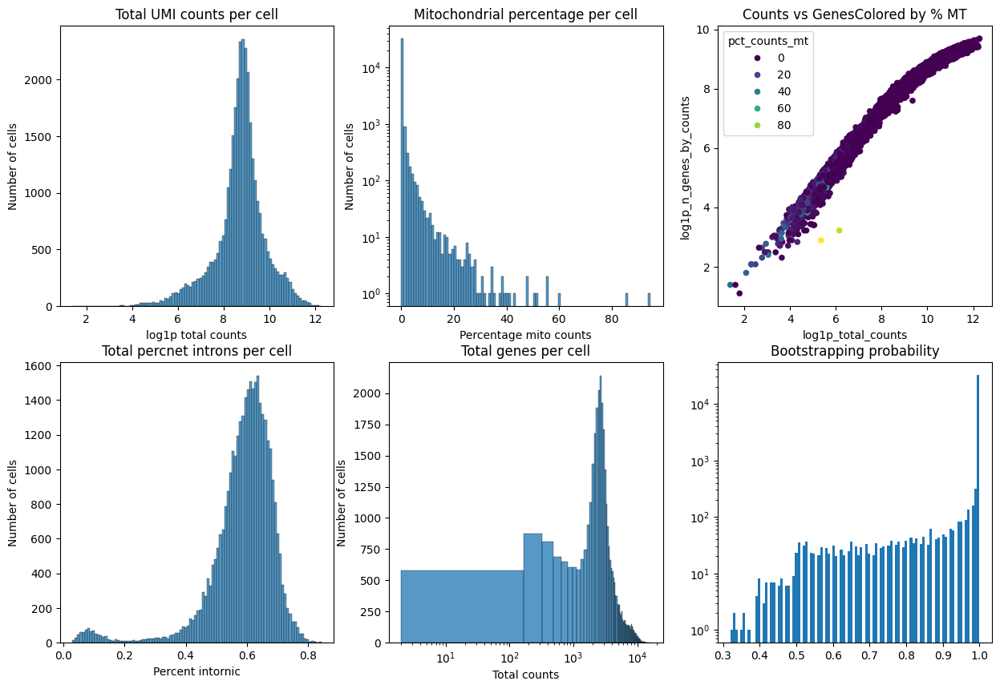

In [4]:
fig, axes = plt.subplots(2,3, figsize=(15, 10))

axes = axes.flatten()

# --- 1. Total UMI counts ---
    # GOOD
        # Single, smooth peak (unimodal distribution)
        # Peak centered around 8-10 on log scale (roughly 3,000-20,000 UMIs)
        # Narrow spread
    # BAD
        # Two peaks (bimodal): Suggests two populations - one could be empty droplets or debris
        # Very wide spread: Indicates high variability in sequencing depth between cells
        # Long left tail: Presence of empty droplets or broken cells
        # peask less than 7
sns.histplot(adata.obs["log1p_total_counts"], bins=100, kde=False, ax=axes[0])
axes[0].set_title("Total UMI counts per cell")
axes[0].set_ylabel("Number of cells")
axes[0].set_xlabel("log1p total counts")

# --- 2. Mitochondrial counts ---
    # GOOD
        # Most cells clustered at lower values
        # Smooth, single-peaked shape
    # BAD
        # Heavy upper tail: Many dying/stressed cells
        # Bimodal (two bumps): Two populations with different health states
sns.histplot(adata.obs["pct_counts_mt"], bins=100, kde=False, ax=axes[1])
axes[1].set_title("Mitochondrial percentage per cell")
axes[1].set_ylabel("Number of cells")
axes[1].set_xlabel("Percentage mito counts")
axes[1].set_yscale("log")

# --- 3. Scatter: counts vs genes, colored by mito ---
    # GOOD
        # Strong positive correlation: Diagonal line from bottom-left to top-right: More total counts = more genes detected
    # BAD
        #  Cells in bottom-left corner (low counts, low genes) --< Empty droplets or debris
sns.scatterplot(
    x=adata.obs["log1p_total_counts"],
    y=adata.obs["log1p_n_genes_by_counts"],
    hue=adata.obs["pct_counts_mt"],
    ax=axes[2],
    s=30,        # point size
    linewidth=0, 
    palette="viridis"
)
axes[2].set_title("Counts vs GenesColored by % MT")

# --- 4. % introns ---
    # GOOD

    # BAD
        # having 2 peaks

sns.histplot(adata.obs["pct_intronic"], bins=100, kde=False, ax=axes[3])
axes[3].set_title("Total percnet introns per cell")
axes[3].set_ylabel("Number of cells")
axes[3].set_xlabel("Percent intornic")

# --- 5. n genes ---
    # GOOD

    # BAD

sns.histplot(adata.obs["n_genes_by_counts"], bins=100, kde=False, ax=axes[4])
axes[4].set_title("Total genes per cell")
axes[4].set_ylabel("Number of cells")
axes[4].set_xlabel("Total counts")
axes[4].set_xscale("log")

# --- 6. mapmycell probs ---
    # GOOD

    # BAD
axes[5].hist(
    adata.obs['Class_bootstrapping_probability'].dropna(),
    bins=100, log=True
)
axes[5].set_title("Bootstrapping probability")

#plt.tight_layout()
plt.show()


# Minimal Filter cells

In [ ]:
# # Filter cells based qc: count per cell, genes per cell, % mt --< using MAD approach 
#     # MAD, sort of std = median of the absloution differcnes form the median
#     # MAD = "How far from typical is this cell?"
#     #Lower threshold = Median - (nmads × MAD)
#     #Upper threshold = Median + (nmads × MAD)
#     # outlier if ANY of these are true --< OR

# def is_outlier(adata, metric: str, nmads: int, direction: str = "both"):
    
#     M = adata.obs[metric]
#     median = np.median(M)
#     mad = median_abs_deviation(M)
    
#     lower_bound = median - nmads * mad
#     upper_bound = median + nmads * mad
    
#     if direction == "both":
#         outlier = (M < lower_bound) | (M > upper_bound)
#     elif direction == "upper":
#         outlier = M > upper_bound
#     elif direction == "lower":
#         outlier = M < lower_bound
#     else:
#         raise ValueError(f"direction must be 'both', 'upper', or 'lower', got '{direction}'")
    
#     return outlier



#'MAD_lower_total_UMI_per_cell': ~is_outlier(adata, "log1p_total_counts", 5, "lower"),


In [5]:
print(f"Starting: {adata.n_obs:,} cells\n")

# Calculate all filters (keep = pass filter)
filters = { # lists of boolen (True == to keep)
    
    'min_UMI': adata.obs["total_counts"] >= 500,
    'min_genes': adata.obs["n_genes_by_counts"] >= 500,
    'mt_threshold': adata.obs["pct_counts_mt"] <= 8,
    'is_cell_dropsift': adata.obs["is_cell"] == True,
    'percent_intronic_threshold': adata.obs["pct_intronic"] >= 0.2,
    'mapmycells_probs_class': (adata.obs['Class_bootstrapping_probability'] >= 0.5), # & (adata.obs['Class_correlation_coefficient'] >= 0.5),
    'spatial_present': ~adata.obs.x.isna(),
}

# Print individual filter stats
n_start = len(adata)
for name, filt in filters.items():
    removed = (~filt).sum()
    print(f"{name:30s}: {removed:6,} removed ({100*removed/len(adata):5.1f}%)")

# Replace adata
cells_to_keep = pd.DataFrame(filters).all(axis=1)  # AND
adata = adata[cells_to_keep].copy()

print(f"Final: {adata.n_obs:,} / {n_start:,} cells retained ({100*adata.n_obs/n_start:.1f}%)")

Starting: 34,704 cells

min_UMI                       :  1,172 removed (  3.4%)
min_genes                     :  2,315 removed (  6.7%)
mt_threshold                  :    248 removed (  0.7%)
is_cell_dropsift              :  1,323 removed (  3.8%)
percent_intronic_threshold    :    813 removed (  2.3%)
mapmycells_probs_class        :     79 removed (  0.2%)
spatial_present               :    739 removed (  2.1%)
Final: 31,241 / 34,704 cells retained (90.0%)


In [6]:
# Filter genes
print(f"   Genes before filtering: {adata.n_vars}")
sc.pp.filter_genes(adata, min_cells=3)
print(f"   Genes after filtering: {adata.n_vars}")

   Genes before filtering: 38606
   Genes after filtering: 33848


# Processing Pipeline

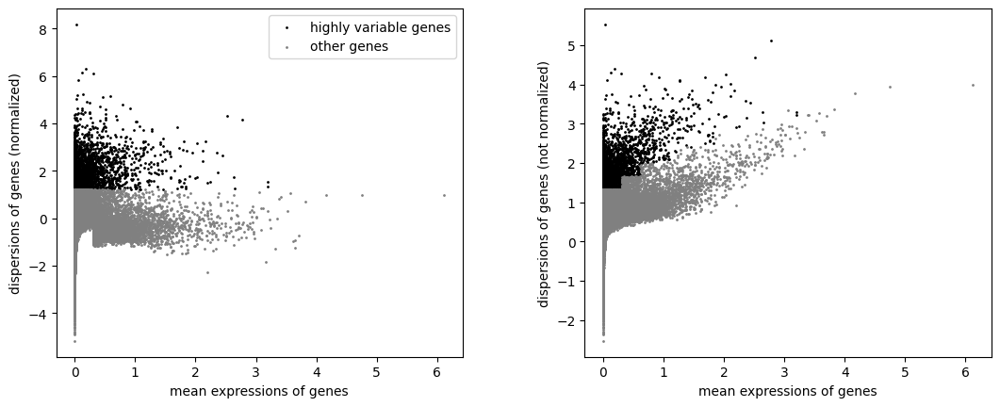

/home/gdallagl/.pyenv/versions/3.11.8/lib/python3.11/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


In [7]:
# Normalize & Transform --> X amtrix changes
sc.pp.normalize_total(adata, target_sum=1e4, inplace=True)
sc.pp.log1p(adata)
adata.layers["log1p_norm"] = adata.X.copy()

# HVG
sc.pp.highly_variable_genes(adata, n_top_genes=3000)
sc.pl.highly_variable_genes(adata, show=True)
    # BAD: nif there is not clear seapration

# scale
sc.pp.scale(adata, max_value=10) #z-score normalization


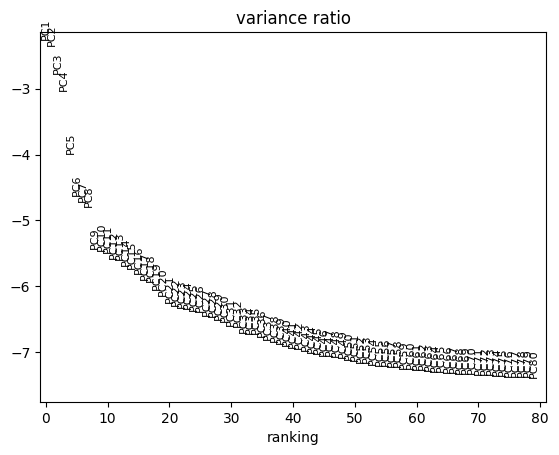

,x,y,pct_intronic,is_cell,Neighborhood_label,Neighborhood_name,Neighborhood_bootstrapping_probability,Neighborhood_aggregate_probability,Neighborhood_correlation_coefficient,Class_label,...,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,leiden_1,leiden_2,leiden_3,leiden_4
AAACCAAAGATAACAG-1,33013.428400,444.562211,0.585746,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.6303,CS20250428_CLASS_0000,...,21.110963,28.975831,44.358392,21,3.091042,0.280411,0,0,0,0
AAACCAAAGCATGGAG-1,21225.159553,4193.340108,0.596834,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.7041,CS20250428_CLASS_0008,...,26.516544,36.810662,55.124081,3,1.386294,0.068934,3,3,2,3
AAACCAAAGGCGGAGT-1,16429.015488,3852.143369,0.716821,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.7610,CS20250428_CLASS_0010,...,31.480911,42.533867,60.899015,0,0.000000,0.000000,4,5,4,4
AAACCAAAGGTCTATG-1,43242.438818,-1822.457007,0.609493,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.6028,CS20250428_CLASS_0000,...,44.152047,58.830409,80.877193,0,0.000000,0.000000,0,0,7,1
AAACCAAAGGTTGTAT-1,14118.369028,-4852.270550,0.588186,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.7130,CS20250428_CLASS_0010,...,35.483871,46.738351,65.017921,4,1.609438,0.095579,4,6,8,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GTTGTGGGTCCGTCCA-1,57226.380126,-635.403689,0.597685,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.7741,CS20250428_CLASS_0010,...,25.170252,33.153530,47.070326,22,3.135494,0.148338,3,3,3,29
GTTGTGGGTCGAAGCC-1,46045.094685,3106.066837,0.630523,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.7561,CS20250428_CLASS_0010,...,29.939091,40.402936,58.472591,7,2.079442,0.109324,4,6,8,7
GTTGTGGGTGCACGTA-1,9851.267283,7168.714885,0.541554,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.7351,CS20250428_CLASS_0010,...,28.037245,37.363287,53.813184,11,2.484907,0.162578,4,6,6,13
GTTGTGGGTGGCGTGT-1,17765.143818,-4292.867209,0.630550,True,CS20250428_NEIGH_0001,Nonneuron,1.0,1.0,0.5699,CS20250428_CLASS_0000,...,43.639740,60.259981,88.115135,0,0.000000,0.000000,0,0,7,1


In [8]:
# PCA
sc.tl.pca(adata, svd_solver='arpack', n_comps=80) # ATTENTION: # Uses HVGs only (if calculted, even if the adat has all geens)
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=80, show=True)
N_PCS_ELBOW = 30

# neighbours (for umap and leiden)
sc.pp.neighbors(adata, use_rep='X_pca', n_pcs=N_PCS_ELBOW) # from X_pca

# umap
sc.tl.umap(adata) # uese neighbors

# clustering
sc.tl.leiden(adata, resolution=0.1, key_added="leiden_1", flavor="igraph", n_iterations=2) # use neighbors
sc.tl.leiden(adata, resolution=0.5, key_added="leiden_2", flavor="igraph", n_iterations=2)
sc.tl.leiden(adata, resolution=1.0, key_added="leiden_3", flavor="igraph", n_iterations=2)
sc.tl.leiden(adata, resolution=2.0, key_added="leiden_4", flavor="igraph", n_iterations=2)

adata.obs


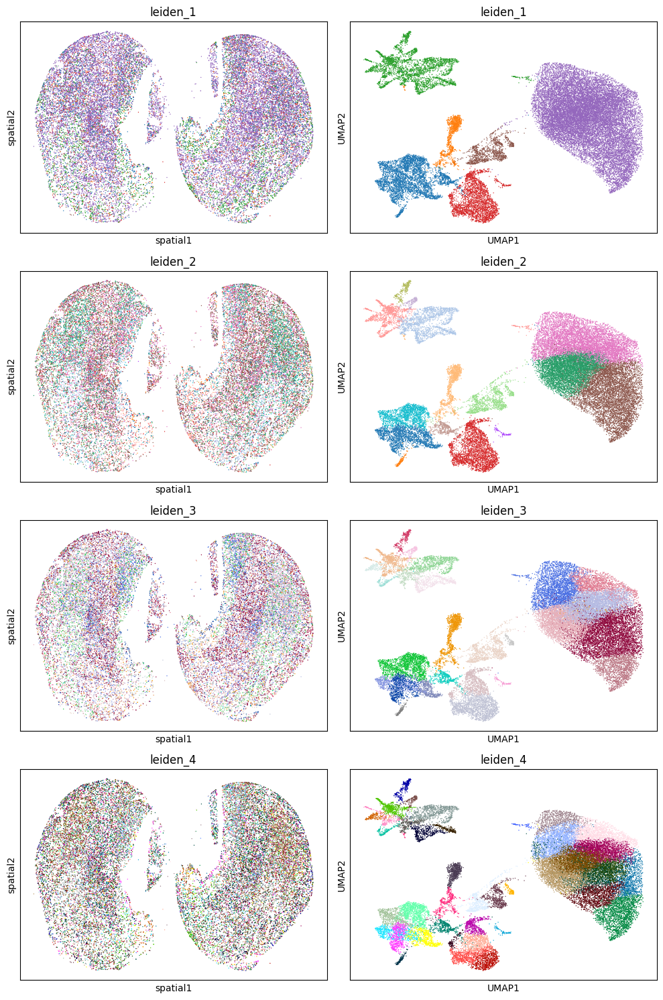

In [11]:
fig, axes = plt.subplots(4, 2, figsize=(10, 15))

for i, res in enumerate(["leiden_1", "leiden_2", "leiden_3", "leiden_4"]):
    sc.pl.embedding(adata, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_loc=None)

plt.tight_layout()
plt.show()

# Filtering by cluster

## Bad quality QC metrics clusters

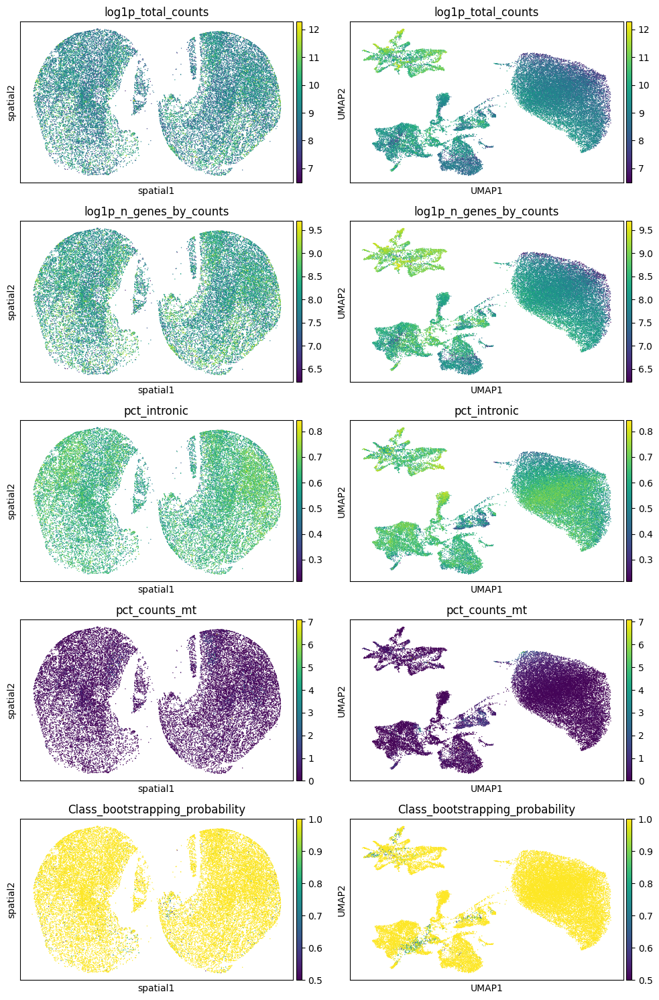

In [27]:
fig, axes = plt.subplots(5, 2, figsize=(10, 15))

for i, res in enumerate(["log1p_total_counts", "log1p_n_genes_by_counts", "pct_intronic", "pct_counts_mt", "Class_bootstrapping_probability"]):
    sc.pl.embedding(adata, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_loc=None)

plt.tight_layout()
plt.show()

['9', '14', '16', '17', '19', '20', '23', '26', '30', '31', '32', '37', '39']


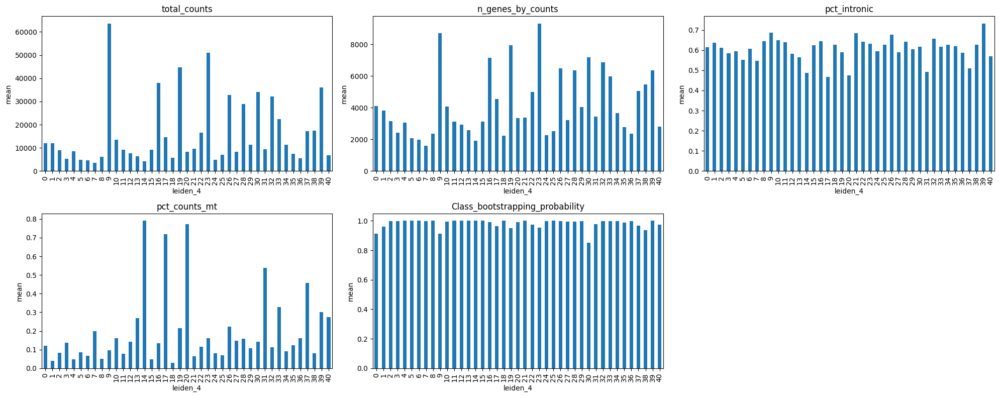

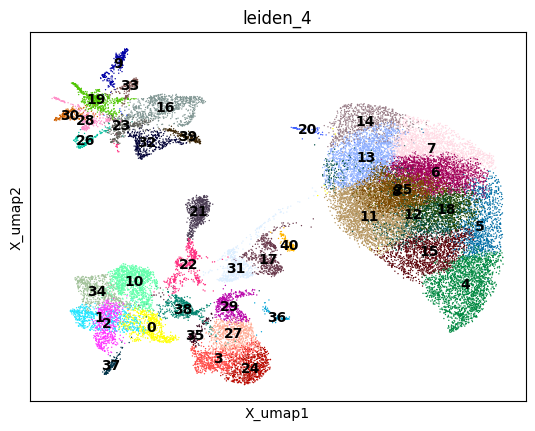

In [ ]:
metrics = [
    "total_counts",
    "n_genes_by_counts",
    "pct_intronic",
    "pct_counts_mt",
    "Class_bootstrapping_probability",
]

# compute mean of each metric for each cluster
df_means = (
    adata.obs
    .groupby("leiden_4", observed=False)[metrics]
    .mean()
    .reset_index()
)


df_means = df_means.set_index("leiden_4")
# display(df_means)

# flag clusters where ANY metric is > 2 SD above mean
# thresholds
putative_bad_clusters_by_qc = df_means[(
    (df_means["total_counts"] > 30000) |
    (df_means["n_genes_by_counts"] > 7000) |
    (df_means["pct_intronic"] < 0.4) | 
    (df_means["pct_intronic"] > 0.8) |
    (df_means["pct_counts_mt"] > 0.4) |
    (df_means["Class_bootstrapping_probability"] < 0.7)
)].index.tolist()
print(putative_bad_clusters_by_qc)


# Plot
fig, axes = plt.subplots(2, 3, figsize=(20, 8))
axes = axes.flatten()

for ax, col in zip(axes, metrics):
    df_means[col].plot(kind="bar", ax=ax)
    ax.set_title(col)
    ax.set_ylabel("mean")
    ax.tick_params(axis="x")#, rotation=45)

# hide any unused axes
for ax in axes[len(metrics):]:
    ax.set_visible(False)

plt.tight_layout()
plt.show()


sc.pl.embedding(adata, basis="X_umap", color="leiden_4", legend_loc="on data")


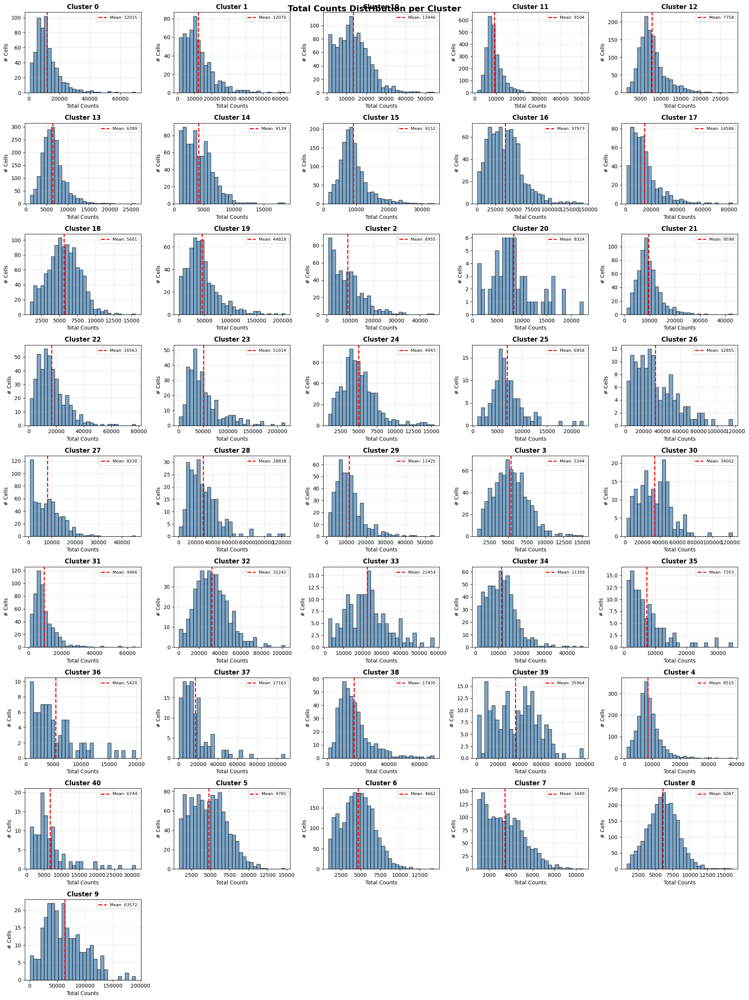

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Get unique clusters
clusters = sorted(adata.obs['leiden_4'].unique())

n_clusters = len(clusters)
ncols = 5
nrows = int(np.ceil(n_clusters / ncols))

fig, axes = plt.subplots(nrows, ncols, figsize=(20, 3*nrows))
axes = axes.flatten()

for idx, cluster in enumerate(clusters):
    ax = axes[idx]
    
    # Get data for this cluster
    cluster_data = adata.obs[adata.obs['leiden_4'] == cluster]['total_counts']
    
    # Plot histogram
    ax.hist(cluster_data, bins=30, color='steelblue', alpha=0.7, edgecolor='black')
    ax.set_title(f'Cluster {cluster}', fontweight='bold')
    ax.set_xlabel('Total Counts')
    ax.set_ylabel('# Cells')
    
    # Add mean line
    mean_val = cluster_data.mean()
    ax.axvline(mean_val, color='red', linestyle='--', linewidth=2, 
               label=f'Mean: {mean_val:.0f}')
    
    # Same x-axis for all
    #ax.set_xlim(global_min, global_max)
    ax.legend(fontsize=8)
    ax.grid(alpha=0.3)

# Hide unused subplots
for idx in range(n_clusters, len(axes)):
    axes[idx].axis('off')

plt.suptitle('Total Counts Distribution per Cluster', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

## Doublets clusters

excluding cell clusters that co-express marker genes of distinct cell types (not UMI based approach).

Problem: Homotypic doublets (formed by transcriptionally similar cells) cannot be detected this way

Check if the doublet cluster is positioned between its "parent" clusters in UMAP space


In [39]:
markers = {
    # Only the MOST selective markers
    'Astrocytes': ['GFAP', 'AQP4'],  # Very specific
    
    'DA_Neurons': ['SLC6A3', 'TH'],  # DA-specific only
    
    'Ependymal': ['ZBBX'],  # Supervisor: "very selective"
    
    'Endothelial': ['FLT1', 'DCN'],  # Supervisor: "selective"
    
    'Microglia': ['P2RY12', 'TMEM119'],  # Microglia-specific (not shared with macrophages)
    
    'Macrophages': ['CD163', 'MRC1'],  # Macrophage-specific (not GPNMB - shared!)
    
    'Neurons_Inhib': ['GAD1', 'GAD2'],  # Inhibitory-specific
    
    'Neurons_Excit': ['SLC17A6', 'SLC17A7'],  # Excitatory-specific
    
    'Oligodendrocytes': ['MOBP', 'MOG'],  # Oligo-specific
    
    'OPCs': ['VCAN', 'PDGFRA']  # OPC-specific
}
mapping_genes_name_dict = adata.var[["gene_symbol"]].to_dict()["gene_symbol"].copy()
symbol_to_varid = {v.upper(): k for k, v in mapping_genes_name_dict.items() if isinstance(v, str)}
translated_markers = {
    celltype: [symbol_to_varid.get(gene.upper(), None) for gene in genes]
    for celltype, genes in markers.items()
}

display(translated_markers)


{'Astrocytes': ['ENSG00000131095', 'ENSG00000171885'],
 'DA_Neurons': ['ENSG00000142319', 'ENSG00000180176'],
 'Ependymal': ['ENSG00000169064'],
 'Endothelial': ['ENSG00000102755', 'ENSG00000011465'],
 'Microglia': ['ENSG00000169313', 'ENSG00000183160'],
 'Macrophages': ['ENSG00000177575', 'ENSG00000260314'],
 'Neurons_Inhib': ['ENSG00000128683', 'ENSG00000136750'],
 'Neurons_Excit': ['ENSG00000091664', 'ENSG00000104888'],
 'Oligodendrocytes': ['ENSG00000168314', 'ENSG00000204655'],
 'OPCs': ['ENSG00000038427', 'ENSG00000134853']}

  Astrocytes: 2 markers
  DA_Neurons: 2 markers
  Ependymal: 1 markers
  Endothelial: 2 markers
  Microglia: 2 markers
  Macrophages: 2 markers
  Neurons_Inhib: 2 markers
  Neurons_Excit: 2 markers
  Oligodendrocytes: 2 markers
  OPCs: 2 markers


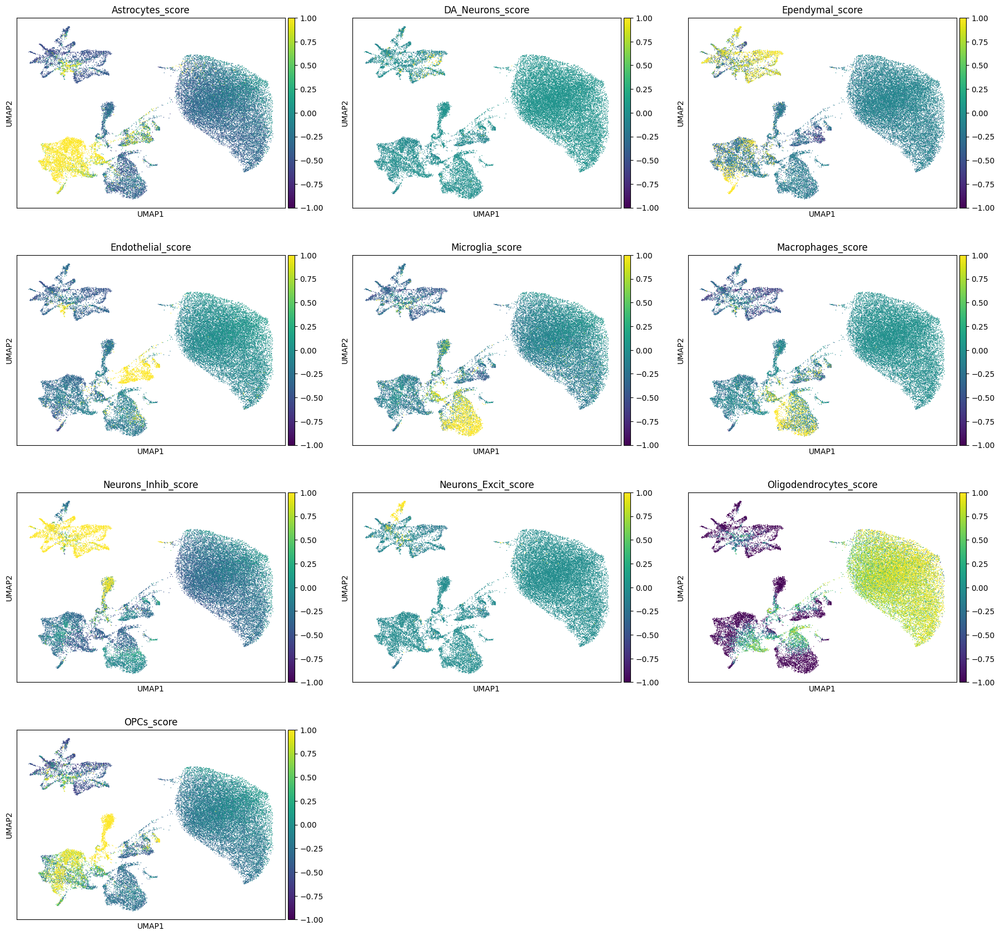

In [40]:
# Compute module score for each cell type
for cell_type, genes in translated_markers.items():
    # Only use genes that exist in your data
    #genes_available = [g for g in genes if g in adata.var.gene_symbol.to_list()]
    
    if len(genes) > 0:
        print(f"  {cell_type}: {len(genes)} markers")
        sc.tl.score_genes(adata, genes, score_name=f'{cell_type}_score') # normalised scores
    else:
        print(f"  ⚠ {cell_type}: No markers found!")

# plot umaps
score_cols = [f'{ct}_score' for ct in markers.keys() if f'{ct}_score' in adata.obs]
sc.pl.umap(adata, color=score_cols, cmap='viridis', ncols=3, vmin=-1, vmax=1)

-1.4299339949082055 8.017843341322193

Mean scores per cluster:


,Astrocytes,DA_Neurons,Ependymal,Endothelial,Microglia,Macrophages,Neurons_Inhib,Neurons_Excit,Oligodendrocytes,OPCs
leiden_4,,,,,,,,,,
0,1.25,-0.04,-0.09,-0.21,-0.21,-0.11,-0.42,-0.05,0.15,0.13
1,1.65,-0.06,0.31,-0.26,-0.21,-0.17,-0.31,-0.07,-0.73,0.10
2,2.87,-0.07,1.06,-0.30,-0.17,-0.21,-0.22,-0.07,-1.24,0.92
3,-0.40,-0.03,-0.24,-0.14,2.01,1.26,-0.10,-0.04,-1.43,-0.29
4,-0.35,0.00,-0.19,-0.10,-0.19,-0.07,-0.31,-0.04,0.76,-0.25
5,-0.27,0.01,-0.16,-0.05,-0.12,-0.04,-0.23,-0.04,0.78,-0.15
6,-0.26,0.02,-0.15,-0.04,-0.10,-0.04,-0.25,-0.03,0.65,-0.14
7,-0.20,0.02,-0.14,-0.01,-0.08,-0.03,-0.18,-0.04,0.74,-0.09
8,-0.31,0.01,-0.16,-0.06,-0.14,-0.05,-0.31,-0.04,0.56,-0.19


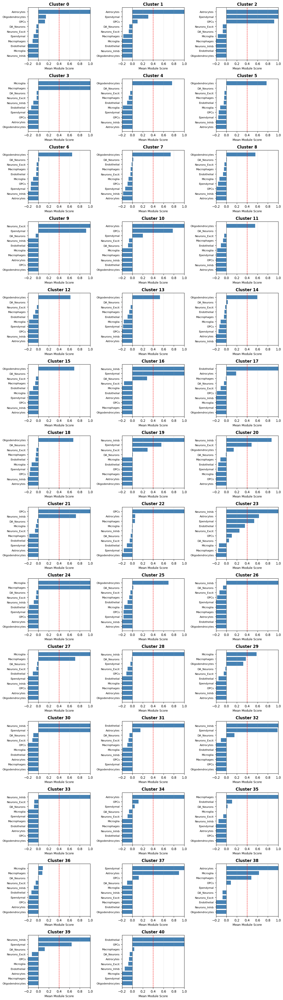

In [ ]:
# Get mean scores per cluster
cluster_scores = adata.obs.groupby("leiden_4", observed=False)[score_cols].mean()

# Clean column names
cluster_scores.columns = [c.replace('_score', '') for c in cluster_scores.columns]

# Simple barplot - one per cluster
n_clusters = len(cluster_scores)
ncols = 3
nrows = int(np.ceil(n_clusters / ncols))

fig, axes = plt.subplots(nrows, ncols, figsize=(4*ncols, 3*nrows))
axes = axes.flatten() if n_clusters > 1 else [axes]

for idx, (cluster, row) in enumerate(cluster_scores.iterrows()):
    ax = axes[idx]
    
    # Sort values for easier reading
    sorted_data = row.sort_values(ascending=True)
    
    # Plot
    ax.barh(range(len(sorted_data)), sorted_data.values, color='steelblue')
    ax.set_yticks(range(len(sorted_data)))
    ax.set_yticklabels(sorted_data.index, fontsize=8)
    ax.set_xlabel('Mean Module Score', fontsize=9)
    ax.set_title(f'Cluster {cluster}', fontweight='bold')
    ax.axvline(0, color='black', linestyle='--', linewidth=0.8)
    ax.grid(axis='x', alpha=0.3)
    ax.set_xlim((-0.2, 1))
    ax.axvline(0.4, linestyle='--', linewidth=1, color="red")

# Hide empty subplots
for idx in range(n_clusters, len(axes)):
    axes[idx].axis('off')

plt.tight_layout()
plt.show()


cluster_scores_filtered = cluster_scores.copy()
cluster_scores_filtered[cluster_scores_filtered<0.5] = "0"
mask = (cluster_scores_filtered != "0").sum(axis=1) > 1
cluster_scores_filtered = cluster_scores_filtered[mask]
display(cluster_scores_filtered.round(2))


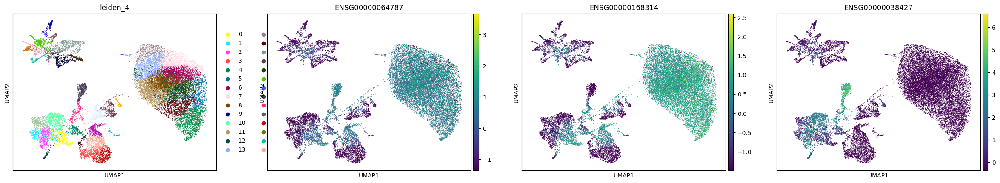

In [ ]:
# Check if they're differentiating OPCs (real) or doublets (artifact)
#(Oligo + OPC)
# REAL BIOLOGY (good) ✓
# OPC differentiating into Oligodendrocyte
# → Transition state, should KEEP!
#  BCAS1 expression (differentiation marker) --> BCAS1 high → Real differentiating cells → KEEP ✓
genes = ['BCAS1', 'MOBP', 'VCAN']
genes_var = [symbol_to_varid[g] for g in genes]
sc.pl.umap(adata, color=['leiden_4']+genes_var)

In [60]:
(cluster_scores_filtered != "0").sum(axis=1) 

leiden_4
0     1
1     1
2     3
3     2
4     1
5     1
6     1
7     1
8     1
9     2
10    2
11    1
12    1
13    1
14    1
15    1
16    2
17    1
18    1
19    2
20    1
21    2
22    1
23    3
24    2
25    1
26    1
27    2
28    1
29    1
30    2
31    1
32    2
33    1
34    1
35    1
36    0
37    2
38    2
39    2
40    2
dtype: int64

In [ ]:
doublets_remove = ['2', '23', '30', '38', '40']


/tmp/ipykernel_136906/4188864126.py:2: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '0' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  cluster_scores_filtered[cluster_scores_filtered<0.5] = "0"


,Astrocytes,DA_Neurons,Ependymal,Endothelial,Microglia,Macrophages,Neurons_Inhib,Neurons_Excit,Oligodendrocytes,OPCs
leiden_4,,,,,,,,,,
2,2.8652,0,1.055255,0,0,0,0,0,0,0.920216
3,0,0,0,0,2.006609,1.261582,0,0,0,0
9,0,0,0.924099,0,0,0,0,5.027317,0,0
10,2.719596,0,0,0,0,0,0,0,0,0.781461
16,0,0,1.479926,0,0,0,2.353506,0,0,0
19,0,0,0.560295,0,0,0,2.431755,0,0,0
21,0,0,0,0,0,0,0.722694,0,0,4.476653
23,0.629348,0,0.534541,0,0,0,1.066656,0,0,0
24,0,0,0,0,3.001193,1.156676,0,0,0,0


# Deep Filter

- QC metrics
- Doublets clusters

# Reprocess Clean Data

# Save

In [ ]:
# adata.write('/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-H1/adata/filtered_adata.h5ad')
# adata = sc.read_h5ad('/home/gdallagl/myworkdir/XDP/data/XDP/disease/240805_SL-EXD_0328_B22FKKYLT4/SI-TT-H1/adata/filtered_adata.h5ad')

# Plot

### Leiden clusters

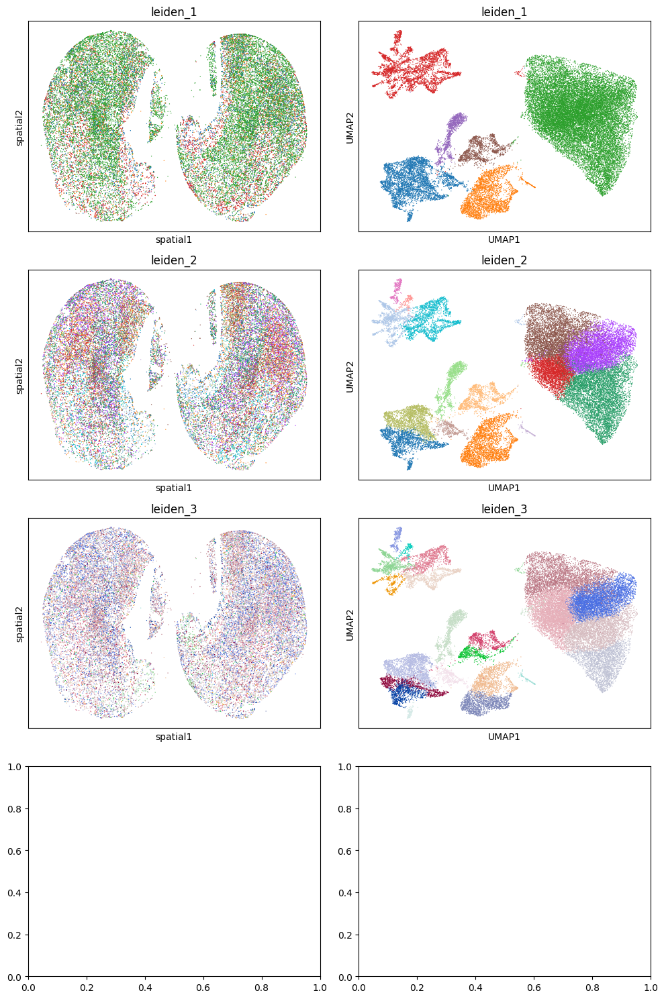

In [ ]:
fig, axes = plt.subplots(3, 2, figsize=(10, 15))

for i, res in enumerate(["leiden_1", "leiden_2", "leiden_3"]):
    sc.pl.embedding(adata, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_loc=None)

plt.tight_layout()
plt.show()

### MapMyCells Labels

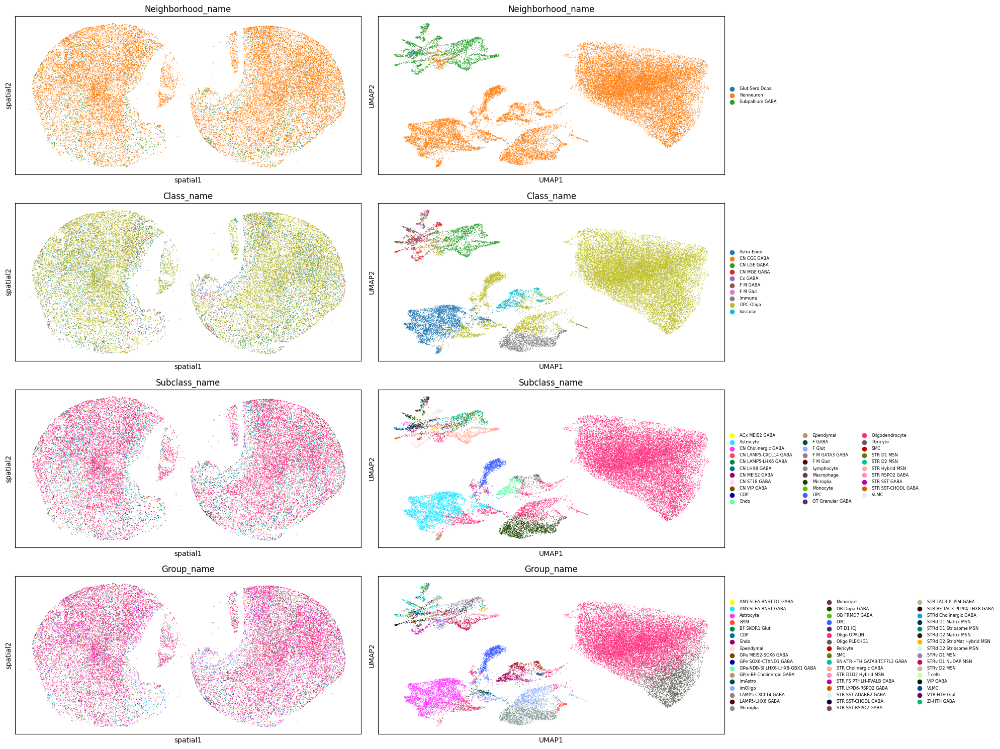

In [21]:
fig, axes = plt.subplots(4, 2, figsize=(20, 15))

for i, res in enumerate(["Neighborhood_name", "Class_name", "Subclass_name", "Group_name"]):
    sc.pl.embedding(adata, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_fontsize=6)# legend_loc="lower center")

plt.tight_layout()
plt.show()

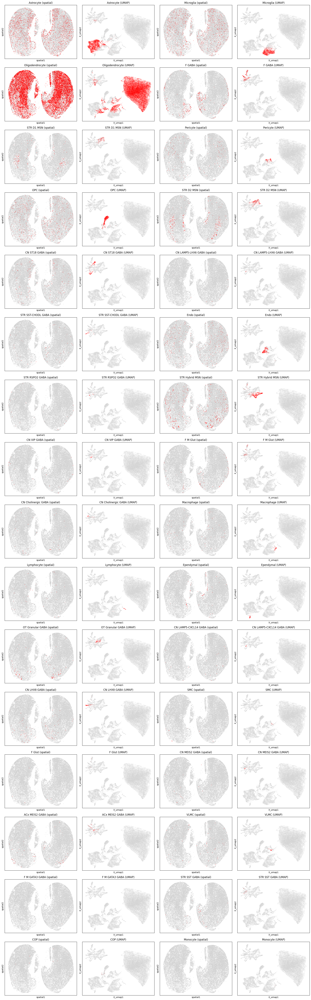

In [22]:
subclasses = adata.obs["Subclass_name"].unique()
n_subclasses = len(subclasses)

# Calculate rows (ceiling division)
n_rows = int(np.ceil(n_subclasses / 2))
n_cols = 4

fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 4*n_rows))
axes = axes.flatten()  # Flatten to 1D for easy indexing

for i, s in enumerate(subclasses):
    # Create highlight column
    adata.obs["temp_highlight"] = adata.obs['Subclass_name'].apply(
        lambda x: s if x == s else 'Other'
    )
    
    # Spatial plot (left side: columns 0, 2, 4, ...)
    sc.pl.embedding(
        adata, 
        basis="spatial", 
        color="temp_highlight", 
        palette={'Other': 'lightgray', s: 'red'}, 
        ax=axes[i*2], 
        show=False, 
        legend_loc=None, 
        size=10,
        title=f"{s} (spatial)"
    )
    
    # UMAP plot (right side: columns 1, 3, 5, ...)
    sc.pl.embedding(
        adata, 
        basis="X_umap", 
        color="temp_highlight", 
        palette={'Other': 'lightgray', s: 'red'}, 
        ax=axes[i*2 + 1], 
        show=False, 
        legend_loc=None,
        title=f"{s} (UMAP)"
    )

# Hide unused subplots
for j in range(i*2 + 2, len(axes)):
    axes[j].axis('off')

# Clean up temp column
adata.obs.drop('temp_highlight', axis=1, inplace=True)

plt.tight_layout()
plt.show()

### Plot QC

In [ ]:
fig, axes = plt.subplots(4, 2, figsize=(20, 15))

for i, res in enumerate(["Neighborhood_name"]):
    sc.pl.embedding(adata, basis="spatial", color=res, ax=axes[i,0], show=False, legend_loc=None)
    sc.pl.umap(adata, color=res, ax=axes[i,1], show=False, legend_fontsize=6)# legend_loc="lower center")

plt.tight_layout()
plt.show()

NameError: name 'adata' is not defined

# MapMyCell cell types

In [3]:
# Add gene name
t = adata.copy()
gene_mapping = pd.read_csv("/home/gdallagl/myworkdir/XDP/data/BioMart/ensamble-name_biomart.txt", sep="\t").set_index("Gene stable ID")
gene_mapping


t.var = t.var.merge(gene_mapping, left_index=True, right_index=True, how="left").rename(columns={"Gene name":"gene_name"})

t.var

,feature_types,genome,gene_symbol,gene_name
ensembl_id,,,,
ENSG00000290825,Gene Expression,GRCh38,DDX11L2,DDX11L16
ENSG00000243485,Gene Expression,GRCh38,MIR1302-2HG,MIR1302-2HG
ENSG00000237613,Gene Expression,GRCh38,FAM138A,FAM138A
ENSG00000290826,Gene Expression,GRCh38,ENSG00000290826,NaN
ENSG00000186092,Gene Expression,GRCh38,OR4F5,OR4F5
...,...,...,...,...
ENSG00000277836,Gene Expression,GRCh38,ENSG00000277836,NaN
ENSG00000278633,Gene Expression,GRCh38,ENSG00000278633,NaN
ENSG00000276017,Gene Expression,GRCh38,ENSG00000276017,NaN


In [10]:
display(t.var[t.var.index == "ENSG00000131095"])

"GFAP" in t.var.gene_symbol.to_list()

,feature_types,genome,gene_symbol,gene_name
ensembl_id,,,,
ENSG00000131095,Gene Expression,GRCh38,GFAP,GFAP


True